In [2]:
%load_ext autoreload
%autoreload 2

import numpy as np
import time
import os
from dotenv import load_dotenv

In [3]:
from napari_sparrow import functions as fc

napari.manifest -> 'napari-spongepy' could not be imported: Cannot find module 'napari_spongepy' declared in entrypoint: 'napari_spongepy:napari.yaml'


# Read in the data 
The first step of the analysis includes defining the paths to both the DAPI stained image and the list of the coordinates for each transcript. 

Afterwards, the image is read in, and is seen as a numpy array for the whole analysis.

The image is expected to be a tiff file, the trancripts location a txt file.

When working with both nucleus and cellwall images, both paths need to be defined here.  

In [4]:
# Path prefix for the data folder, use variable from .env file or default
DATA_PATH_PREFIX = os.getenv("DATA_PATH_PREFIX", default="../data")
DATA_PATH_PREFIX='/Users/arnedf/VIB/DATA/resolve'
DATA_PATH_PREFIX='/srv/scratch/data/spatial'
SMALL_IMAGE = os.getenv("SMALL_IMAGE", default="False") in ["True", "true", "t"]
DEVICE = os.getenv("DEVICE", default="cpu")

OUTPUT_DIR='/srv/scratch/lottep/Sparrow/Segmentation_comparison_RESOLVE/sdata_objects/temp7'

name_slide = "A1-1"
path_coordinates = DATA_PATH_PREFIX + "/resolve_liver/20272_slide1_" + name_slide + "_results.txt"
path_image = DATA_PATH_PREFIX + "/resolve_liver/20272_slide1_" + name_slide + "_DAPI.tiff"

crop_segment=False # set to True to run segmentation step on a crop
if crop_segment:
    crop_param=[ 5000, 3000, 4000 ] #x,y,size
else:
    crop_param=None

#### Convert to zarr and load the image. 

In [5]:
import os
from pathlib import Path

layer_name = "raw_image"

sdata = fc.create_sdata(
    filename_pattern=path_image,
    output_path=os.path.join(OUTPUT_DIR, "sdata.zarr"),
    layer_name=layer_name,
    chunks=1024,
)

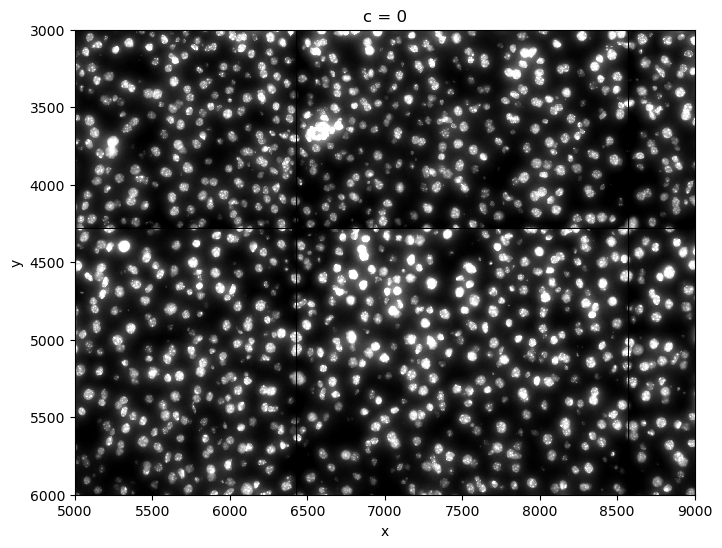

In [6]:
crd=[ 5000, 9000, 3000, 6000 ] # crd used for visualization purposes

fc.plot_image_container( sdata, layer='raw_image', crd=crd, figsize=( 8,8 ) )

# Processing the image(s)

When working with RESOLVE data, the data is acquired in tiles, and the illumination within a tile isn't always constant. Sometimes one side of a tile is more illuminated than the other, influencing the downstream analysis greatly. RESOLVE assured us this isn't linked to the counts of the transcripts, but this can be checked further on.

Basic is a tool that can correct for this, and is used in this function, the size of a tile, 2144, is hardcoded, and used to defined the tile. 

If you don't see any tiling effects, this step might not be necessary. 

INFO:basicpy.basicpy:Initializing BaSiC 140167936800896 with parameters: 
smoothness_flatfield: 1

INFO:basicpy.basicpy:=== BaSiC fit started ===
INFO:basicpy.basicpy:reweighting iteration 0
INFO:basicpy.basicpy:single-step optimization score: 7.006038913459633e-07.
INFO:basicpy.basicpy:mean of S: 1.0.
INFO:basicpy.basicpy:Iteration 0 finished.
INFO:basicpy.basicpy:reweighting iteration 1
INFO:basicpy.basicpy:single-step optimization score: 8.519558036823582e-07.
INFO:basicpy.basicpy:mean of S: 1.0000001192092896.
INFO:basicpy.basicpy:Iteration 1 finished.
INFO:basicpy.basicpy:reweighting score: 0.00963823776692152
INFO:basicpy.basicpy:elapsed time: 4.732266329228878 seconds
INFO:basicpy.basicpy:Reweighting converged.
INFO:basicpy.basicpy:=== BaSiC fit finished in 5.749993547797203 seconds ===
INFO:basicpy.basicpy:=== BaSiC transform started ===
INFO:basicpy.basicpy:=== BaSiC transform finished in 1.700593240559101 seconds ===


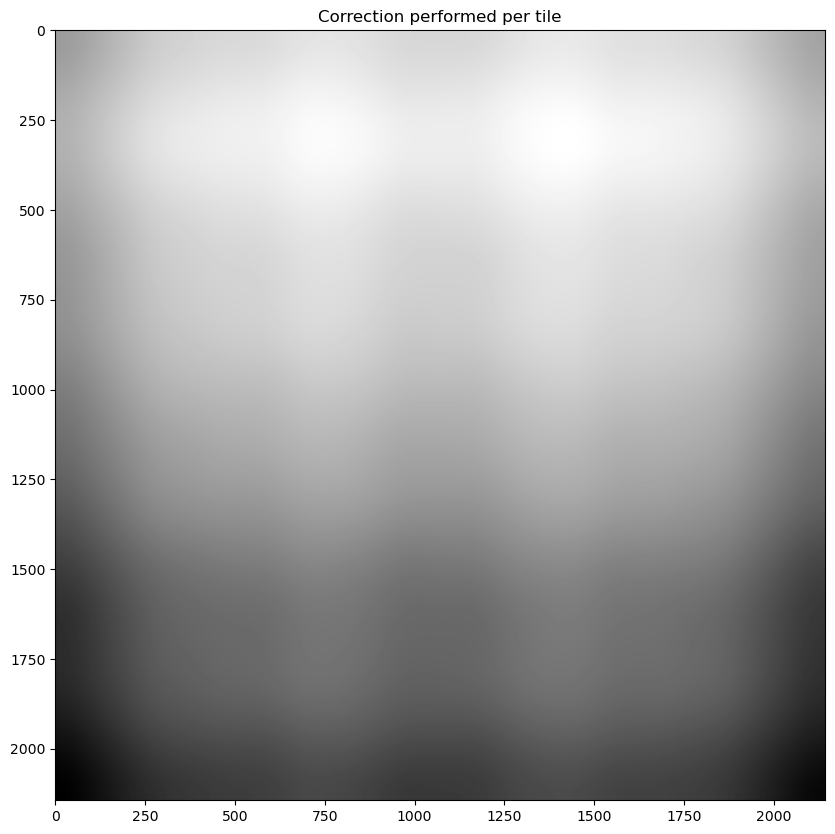

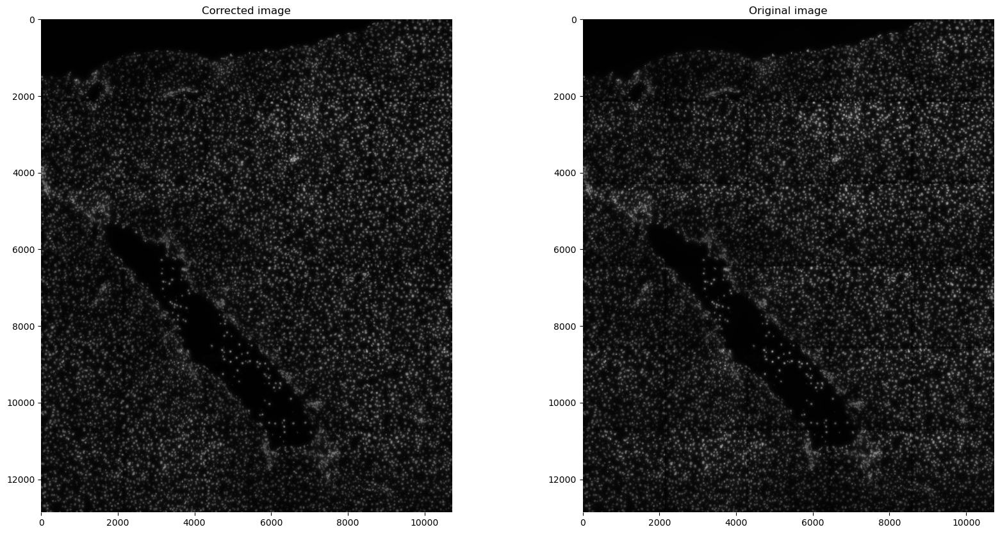

In [7]:
sdata, flatfield = fc.tilingCorrection(
    sdata=sdata, 
    crop_param=crop_param,
    output_layer="tiling_correction"
    )
fc.tilingCorrectionPlot( 
    img=sdata["tiling_correction"].squeeze().to_numpy(),
    flatfield= flatfield, 
    img_orig=sdata["raw_image"].squeeze().to_numpy(), 
    )

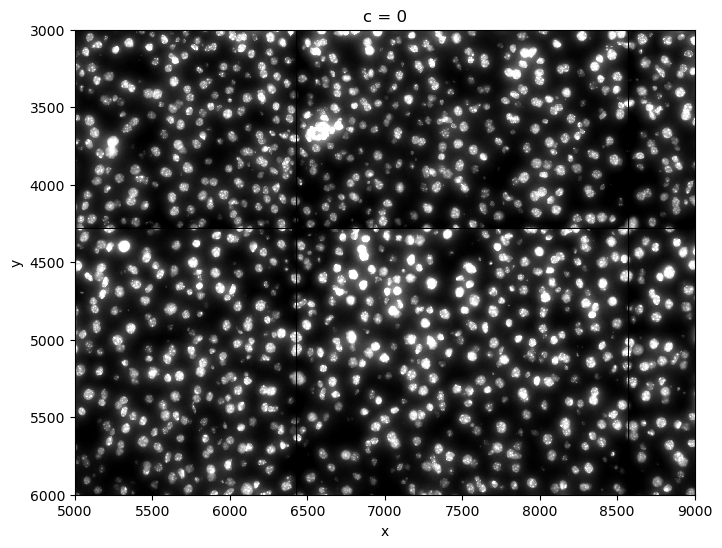

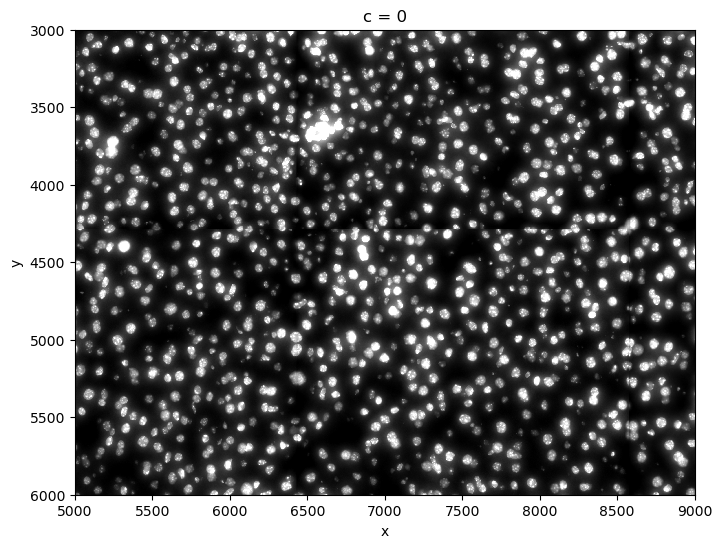

In [8]:
fc.plot_image_container( sdata, layer='raw_image', crd=crd, figsize=( 8,8 ) )
fc.plot_image_container( sdata, layer='tiling_correction', crd=crd, figsize=( 8,8 ) )

The second step of the preprocessing the data includes a couple of steps:

- RESOLVE has missing data on the borders of two tiles, resulting in black lines on the border between tiles. This can split up cells, and thus influence the analysis. 
inpainting this black line circumvents this
- Secondly, a tophatfilter can be added, by defining the size of the tophat filter. If the size of the tophatfilter is not defined, no tophatfilter is added. (I am not sure it actually still is a tophat filter). The goal of this function is to substract background noise, and make the borders of the nuclei cleaner, plus it will delete the occasional debris. If you take the size too small, smaller then the size of your nuclei, the function will create donuts, with black spots in the center of your cells.  If the size of the tophat filter is chosen too big, not enough background is substracted, so a tradeoff should be made. This might need some finetuning. More information can be found on https://biapol.github.io/blog/ryan_savill/03_background_subtraction/. For nuclei, 45-55 is a great starting point. Bigger for whole cells
- Thirdly, this function enhances the contrast, meaning it makes the white and black more separate. It does this by using histogram equalization (CLAHE function). The amount of correction needed can be decided by adapting the contrast_clip value. If the image is already quite bright, 3.5 might be a good starting value. For dark images, you can go up to 10 or even more. 

The result of this function is a cleaned up images, that will give rise to better segmentation results. 


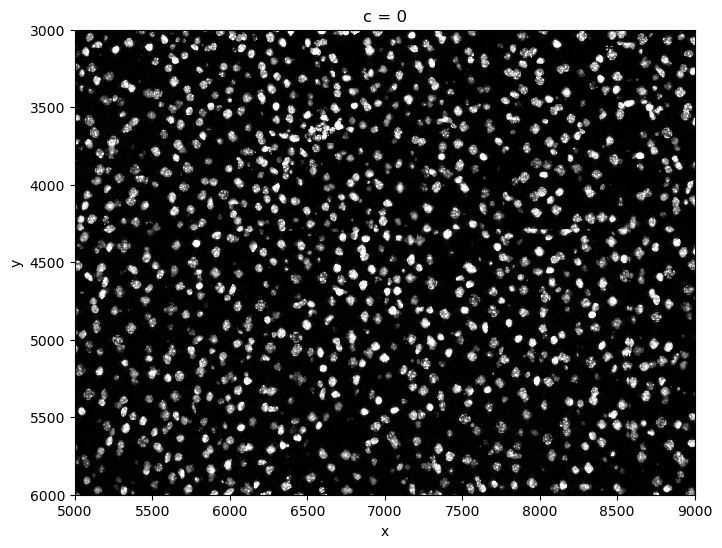

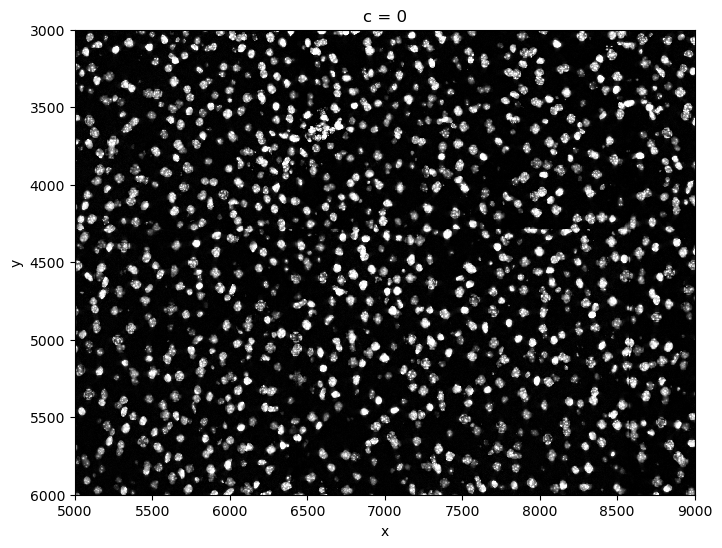

In [9]:
sdata=fc.tophat_filtering( sdata=sdata, output_layer='tophat_filtered' , size_tophat= 45 )
fc.plot_image_container( sdata, layer='tophat_filtered', crd=crd, figsize=( 8,8 ) )
sdata=fc.clahe_processing( sdata=sdata, output_layer='clahe', contrast_clip=3.5, chunksize_clahe=20000 )
fc.plot_image_container( sdata, layer='clahe', crd=crd, figsize=( 8,8 ) )

# Segmenting the image

For the segmentation, we make use of Cellpose, a deep learning network based on a UNET architecture. This is a great tool , because it segments both nuclei and whole cells. This will make it possible to locate all the visible cells in the tissue. 
Multiple paramters need to be given as an inpute to the cellpose algorithm. 
- layer: This parameter decides on which image you want to perform the segmentation. In general, this will be clahe, as this is the fully processed image layer. 
- output_layer: name the output layer of the object. by default it is called segmentation_mask.
- crop_param: this parameter indicates on which part of the image the segmentation is run. 
- diameter: Includes an estimate of the diameter of a nucleus. If put to none, cellpose will do the estimation by himself, but this estimation might take longer than the actual segmentation. You can run the algorthim on a small piece (I[0:1000,0:1000] for example), to get an estimate. However, this estimate isn't always accurate. So check the quality at the end. If you see all nuclei/cells are estimated too small, enlarge this parameter.
- device: Defines the device you want to work on, if you only have cpu, you can skip this input parameter. If only having CPU, please tune the parameters on a small subset, and then make it to the big one. This might take a while. If that doesn't work, because of memory issues, you can always split up the image and paste it together, careful with mask numbering though.
- flow_threshold: Indicates something about the shape of the masks, if you increase it, more masks with less round shapes will be accepted. Up to one:  I take it between 0.6 and 0.95
- mask_threshold: Indicates how many of the possible masks are kept. Making it smaller (up to -6), will give you more masks, bigger is less masks. I take it between 0 and -6. Be careful, you can oversegment: always check the quality 
- min_size: Indicates the minimal size of a nucleus. 
- If segmenting whole cells instead of nuclei, set the parameter model_type to 'cyto'.
- If using nuclei together with whole cells, put model_type to 'cyto', make sure your image is 3D and and that the first channel is your DAPI stained image and the second one is the complete cell staining, put the parameter channel to np.array([2,1]). 
- by setting the chunk size and indicating lazy=True, we make sure the segmentation doesn't crash the computer. If you still have memory issues, you can lower the chunk size. 


In [11]:
sdata

SpatialData object with:
├── Images
│     ├── 'clahe': SpatialImage[cyx] (1, 12864, 10720)
│     ├── 'raw_image': SpatialImage[cyx] (1, 12864, 10720)
│     ├── 'tiling_correction': SpatialImage[cyx] (1, 12864, 10720)
│     └── 'tophat_filtered': SpatialImage[cyx] (1, 12864, 10720)
├── Labels
│     └── 'segmentation_mask': SpatialImage[yx] (12864, 10720)
└── Shapes
      └── 'segmentation_mask_boundaries': GeoDataFrame shape: (11908, 1) (2D shapes)
with coordinate systems:
▸ 'global', with elements:
        clahe (Images), raw_image (Images), tiling_correction (Images), tophat_filtered (Images), segmentation_mask (Labels), segmentation_mask_boundaries (Shapes)

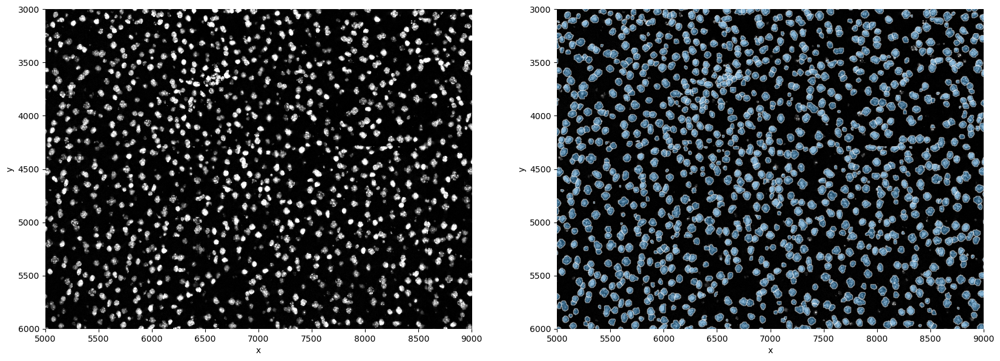

In [13]:
sdata=fc.segmentation_cellpose( 
    sdata=sdata, 
    layer='clahe',
    crop_param=crop_param,
    device='cuda:0',
    min_size=80,
    flow_threshold=0.9,
    diameter=50,
    cellprob_threshold=-4,
    model_type='nuclei',
    chunks=2048,
    lazy=True
      )
fc.segmentationPlot( sdata=sdata, crd=crd, shapes_layer='segmentation_mask_boundaries' )

After we have created our masks, we can decide to expand them. 
This is mainly of interest if we are working with DAPI-stained images. 

The results of this expansion can be mixed, as cytoplasm of multiple celltypes may be assigned to one cell. 
The radius defines how many pixels you go beyond the border of your nucleus. 

Remember that for RESOLVE, the pixelsize is 138 nm. 

If pixels would be belonging to multiple cells because of this expansion, they are assigned to the closest one

In [14]:
voronoi=True
if voronoi:
    sdata=fc.create_voronoi_boundaries( sdata,radius=20, shapes_layer= 'segmentation_mask_boundaries' )

In [15]:
fc.segmentationPlot( sdata=sdata, crd=crd, shapes_layer='expanded_cells20' )

# Creating the anndata object and allocating the transcripts 
First, the transcript locations are read in, and added to the spatialdata object. 

If the locations of the transcripts don't match the image, a transformation matrix can be given as extra input. 

If no transformation matrix is given, no transformations are performed. 
In general, RESOLVE data doesn't require a transformation matrix. 

Secondly, the allocation steps happens: 
- The transcripts are assigned to the cells. This is determined by the location of the transcripts and the location of the cells. 
- By specifying the shapes_layer, you can determine based on which cell shapes the allocation happens: whole cell/nucleus or expanded nucleus. 
- Only cells with transcripts are retained, and the cells without trasncripts are added to "filtered_segmentation +name of the shapes layer used". 
- sdata.table is created, this is an anndata object compatible with squidpy and scanpy. 


In [ ]:
#transformed_ddf=fc.apply_transform_matrix(
#    path_count_matrix=path_coordinates,
#    output_path=os.path.join( OUTPUT_DIR, 'detected_transcripts_transformed.parquet' ),
#    delimiter='\t',
# )

sdata=fc.read_resolve_transcripts(
    sdata,
    path_count_matrix=path_coordinates
)

sdata=fc.allocation( 
    sdata=sdata,
    shapes_layer='nucleus_boundaries'
  )

No transform matrix given, will use identity matrix.
[[1. 0. 0.]
 [0. 1. 0.]
 [0. 0. 1.]]
creating masks from polygons
Created masks with shape (12864, 10720)
Calculate cell counts
Create anndata object


A check can be done. For one cell and one transcript, a small plot can be created, to recount the transcripts, or just to zoom in on a specific cell.

In [ ]:
# some sanity checks
sdata.table[  '130' , 'Ghr' ].to_df()

gene,Ghr
cells,
130,4


plot transcripts matrix for cell 130 and gene Ghr
Plotting 35 transcripts.
Selecting boundaries
Plotting boundaries
End plotting boundaries


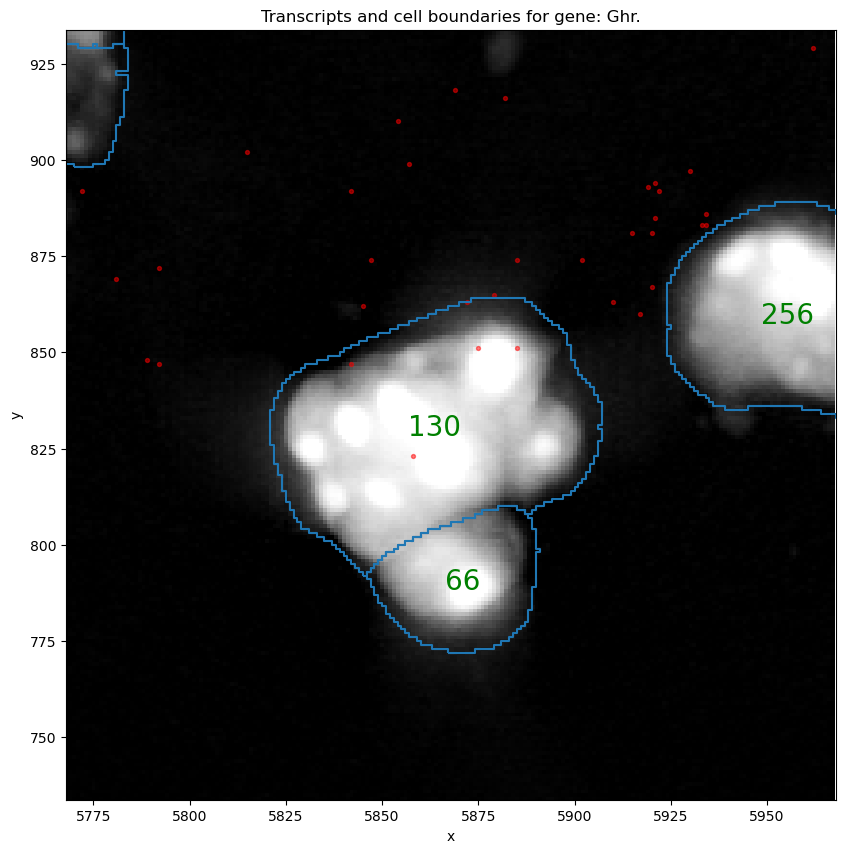

In [ ]:
random_cell='130'
random_gene='Ghr'

diameter=50

if random_cell is not None and random_gene is not None:

    cell_center= sdata.table.obsm[ 'spatial' ][ sdata.table.to_df().index.get_loc( str(random_cell) ) ]
    crd_temp=[ cell_center[0] - (diameter +50 ),  
            cell_center[0] + (diameter +50 ),   
            cell_center[1] - (diameter +50 ), 
            cell_center[1] + (diameter +50 ) ]

    print( f"plot transcripts matrix for cell {random_cell} and gene {random_gene}" )

    fc.sanity_plot_transcripts_matrix( 
        xarray=sdata[ 'clahe' ], 
        in_df=sdata[ 'transcripts' ],
        crd=crd_temp,
        polygons=sdata[ 'nucleus_boundaries' ],
        plot_cell_number=True, 
        gene=random_gene,
        )

The whole slice can be plotted, where all cells are shown. 
For more information on this plotting function, read the description :D. 

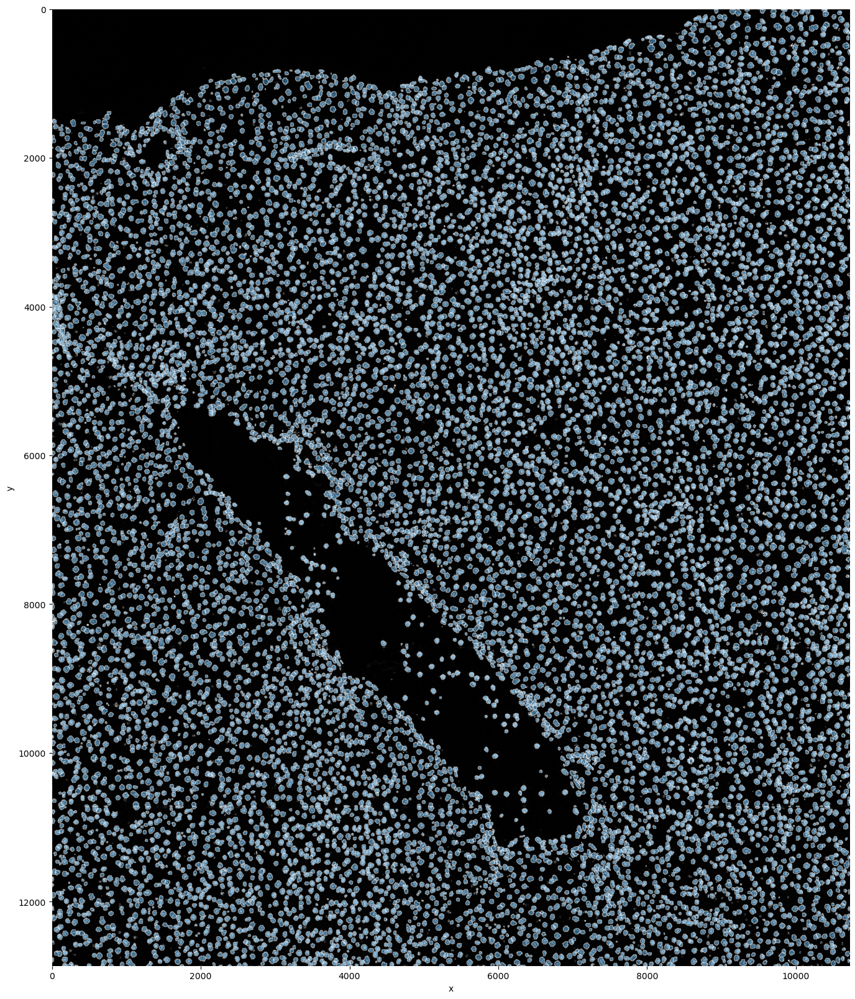

In [ ]:
fc.plot_shapes(sdata,shapes_layer='nucleus_boundaries')

After we have created the anndata object, we control the transcript quality. 

First we create a plot to check if the transcript density is similar across the whole tissue.
Depending on the panel choice, it is possible it depends on the region. This can also be checked here. 
This however, doesn't work well on very large data: if your data is larger than 40.000*40.000 pixels, this function doesn't work yet. 

Secondly, we will have a look at how many transcripts per gene we actually are using. This will be very gene-dependent, as some genes are marker genes for bigger cells than other genes, and thus have more cytoplasm with transcripts. It is important to control whether there are no genes completely lost.

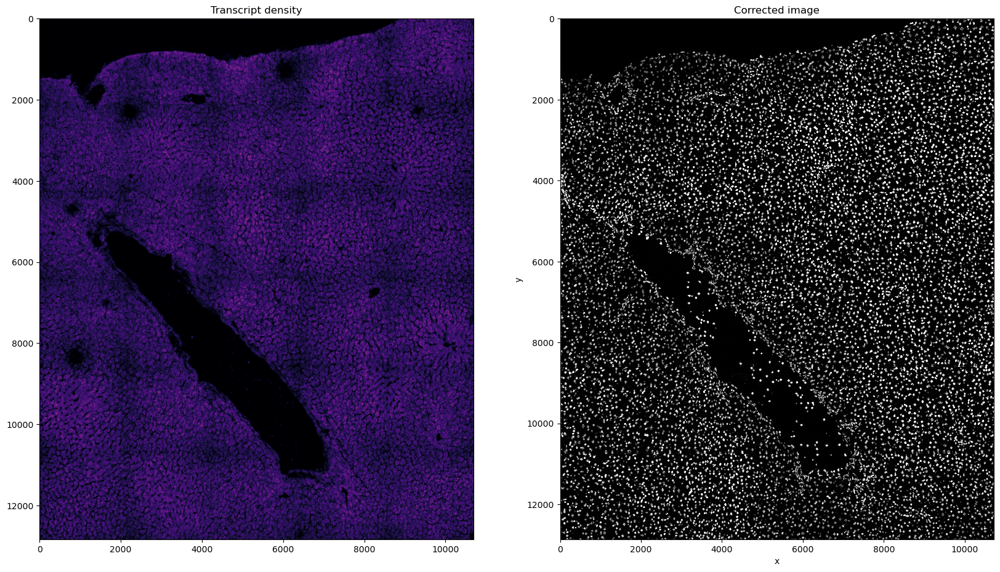

In [ ]:
# TODO: this will not scale well for vizgen, also need to add support for crops
blurred=fc.control_transcripts( sdata[ 'transcripts' ].compute() ) #do we ad this image to the sdata object? 
fc.plot_control_transcripts(blurred,sdata)

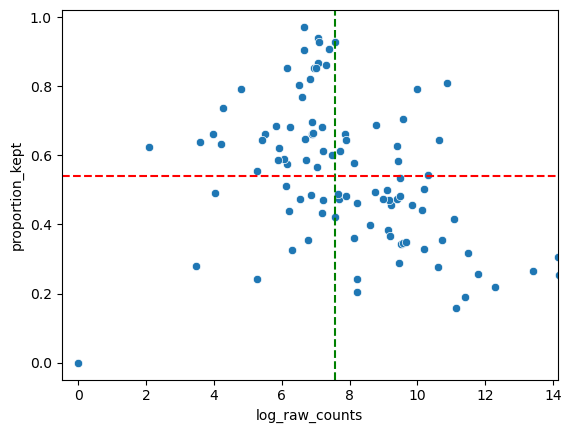

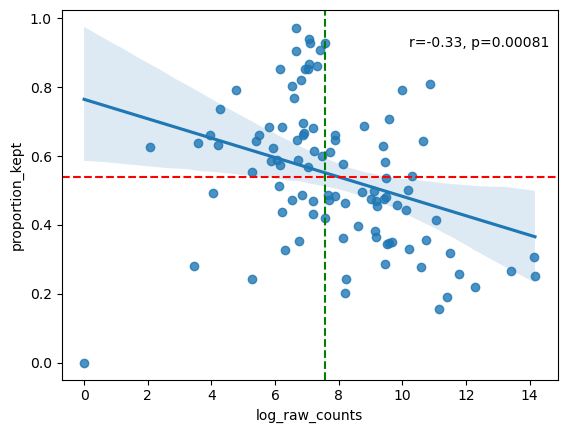

The ten genes with the highest proportion of transcripts filtered out
          proportion_kept  raw_counts
gene                                 
Ms4a7            0.000000           1
Gls2             0.157456       69035
Glul             0.190887       89823
Atp6v0d2         0.203759        3671
Ghr              0.219817      215502
Des              0.241714        3711
Folr2            0.242268         194
Cyp2e1           0.252710     1421904
Hal              0.256150      130806
Fn1              0.266335      677966


In [ ]:
filtered=fc.analyse_genes_left_out(sdata,sdata[ 'transcripts' ].compute())

# Preprocess sdata.table 

This next code  preprocesses the sdata.table object. 
- calculate QC metrics
- filter cells with less then **min_counts** gene counts and genes with less then **min_cells** cells (default values are 10 counts per cell and 5 cells per gene). 
- Cells with less counts are added to the shapes layer filtered_low_counts+name segmentation_mask. 
- Nuc_Size_norm: standard: perform normalization based on the size of the cell/nucleus, followed by scaling. If put to False, normal library size normalazation is performed. For data with less than 100 genes, we recommend scaling based on cell size. 
- the raw counts are saved under sdata.table['layers']['raw_counts']. The normalized, unscaled counts are saved at sdata.table.raw.X. The scaled counts at sdata.table.X. 

The last plot shows the size of the nucleus related to the counts. When working with whole cells, large cells with low counts are probably not real cells and should be filtered out based on max size.

In [ ]:
sdata

SpatialData object with:
└── Images
      ├── 'raw_image': SpatialImage[cyx] (1, 12864, 10720)
      └── 'tiling_correction': SpatialImage[cyx] (1, 12864, 10720)
with coordinate systems:
▸ 'global', with elements:
        raw_image (Images), tiling_correction (Images)

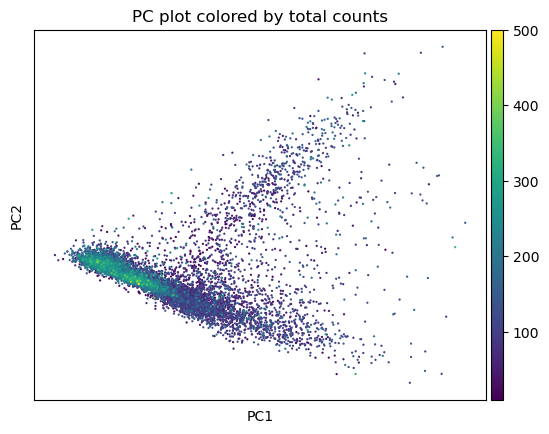

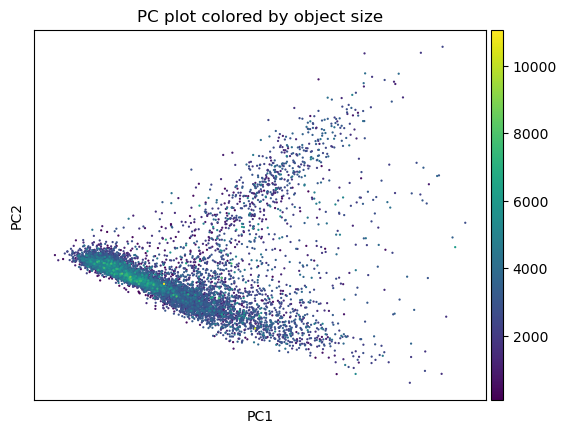

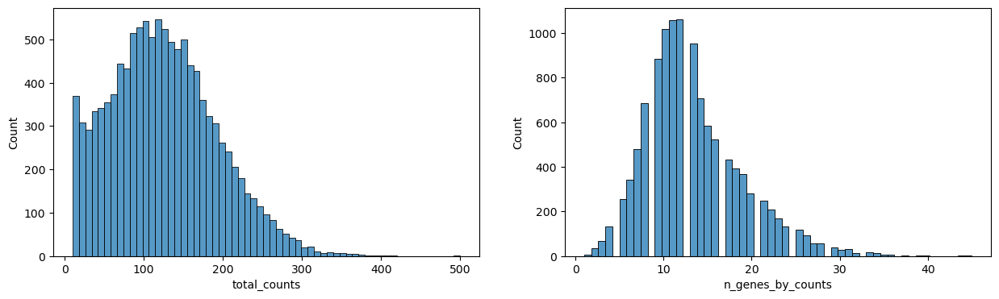

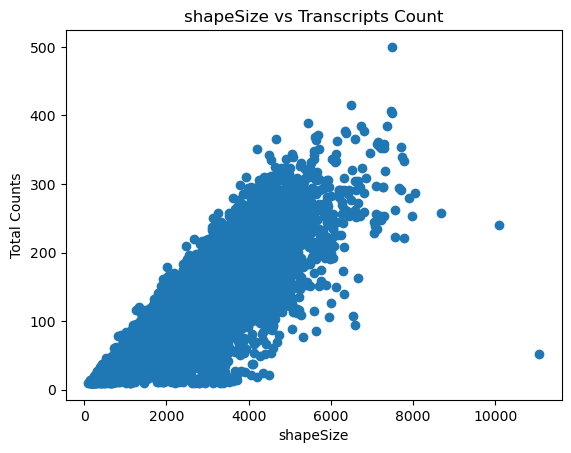

In [ ]:
sdata = fc.preprocessAdata(
    sdata=sdata, 
    nuc_size_norm=True,
    shapes_layer='nucleus_boundaries',
    )  
fc.preprocesAdataPlot(sdata , ) 

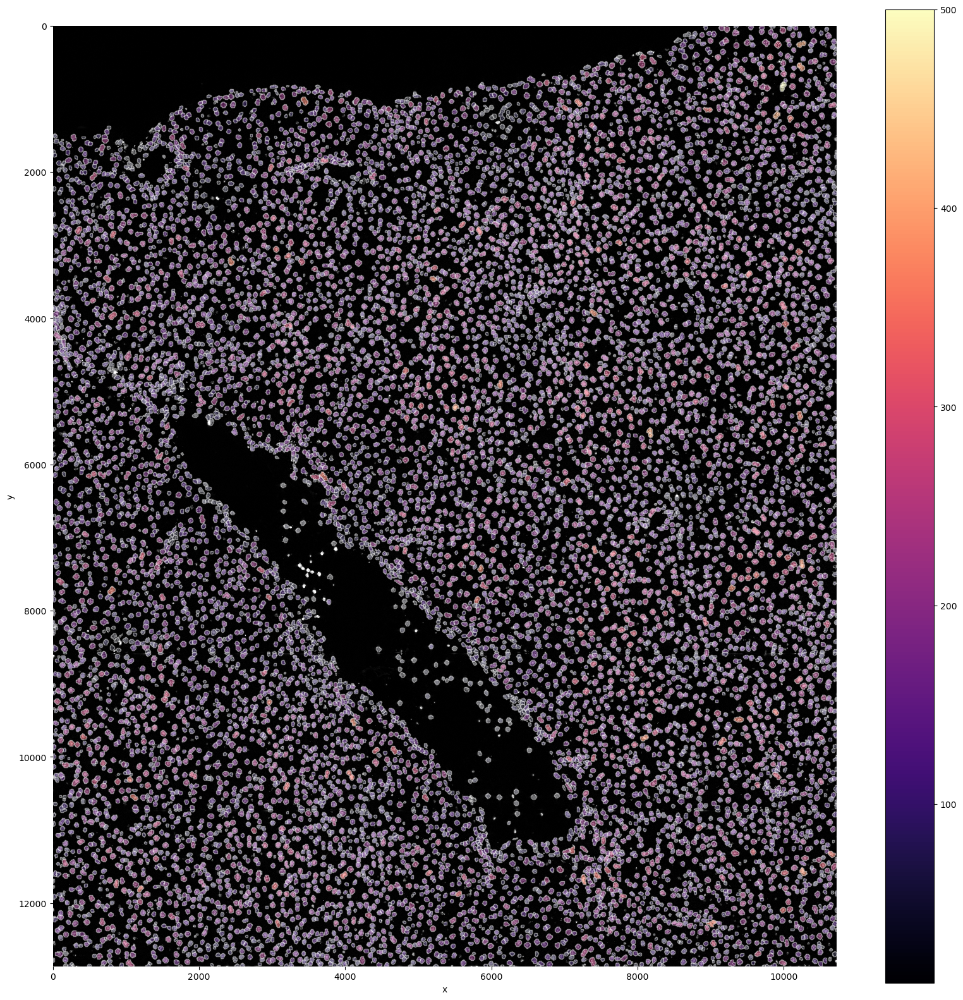

In [23]:
fc.plot_shapes(sdata, column="total_counts")

## Filter cells on size
In this step you can filter cells based on their size: are you sure cells need to be bigger, or sure your cells can not be larger than X? 

You can delete them with this function by defining min_size and max_size. Use the last plot from the preprocess function to determine these thresholds.
The cells that are filtered out are added to the shapes layer under 'filtered_size+name of layer'

271 cells were filtered out based on size.


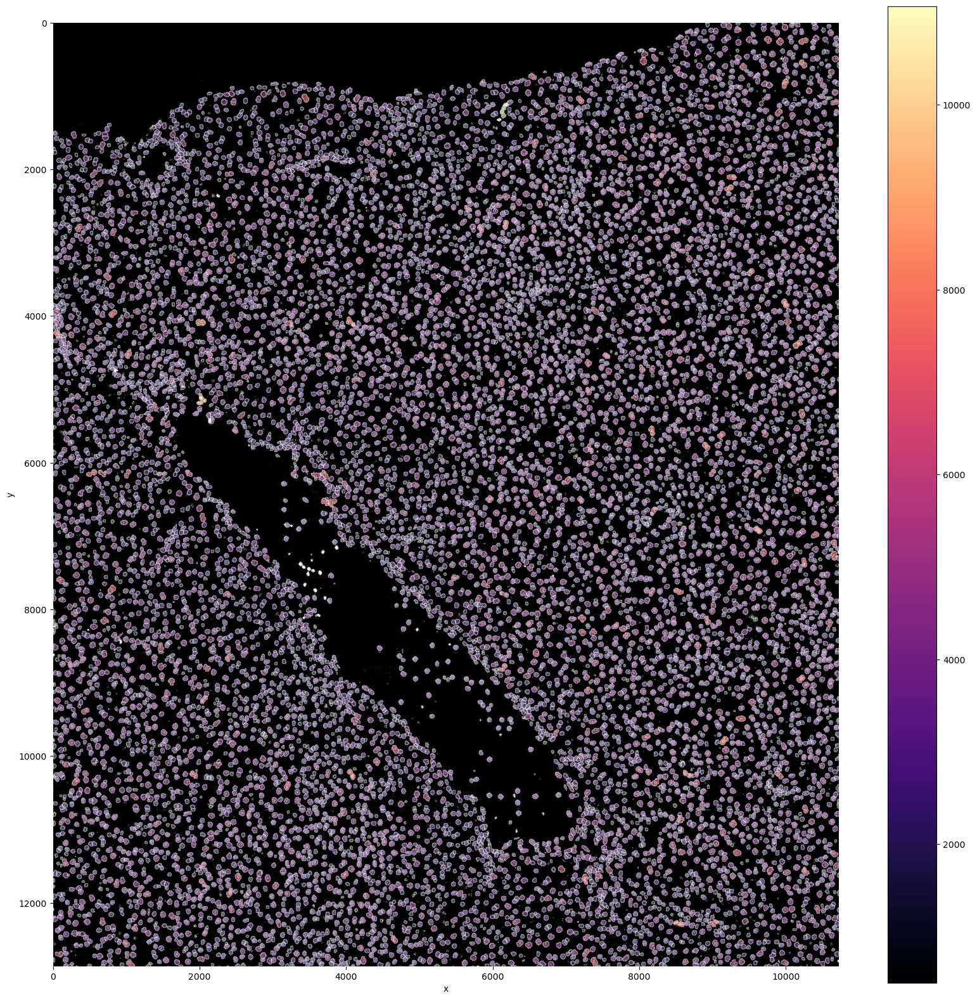

In [26]:
sdata = fc.filter_on_size(sdata, min_size=500)
fc.plot_shapes(sdata, column="shapeSize")

## Clustering 
This function performs the neighborhood analysis and the leiden clustering and the UMAP (standard scRNA-seq).

You need to define 2 parameters:
- the amount of PC's used: I normally choose something between 15-20 based on the plot.
- The amount of neighbors used: Normally I go for 35. If your dataset is small, (less than 2000 cells), go for less. The bigger this parameter, the more everything will be centered (in general).

It returns the UMAP and marker gene list per cluster, that can be looked at for finding celltypes. 

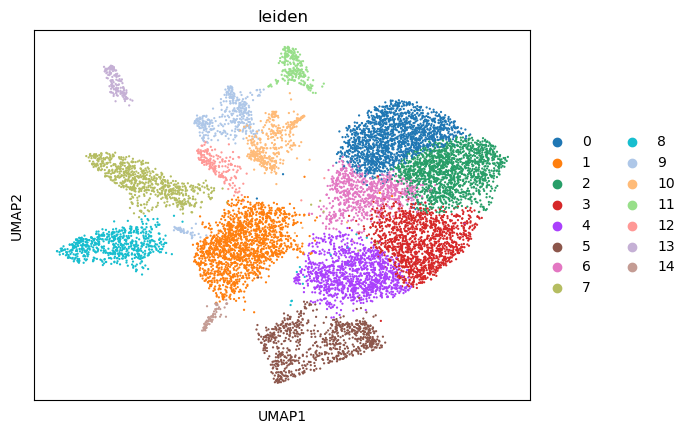

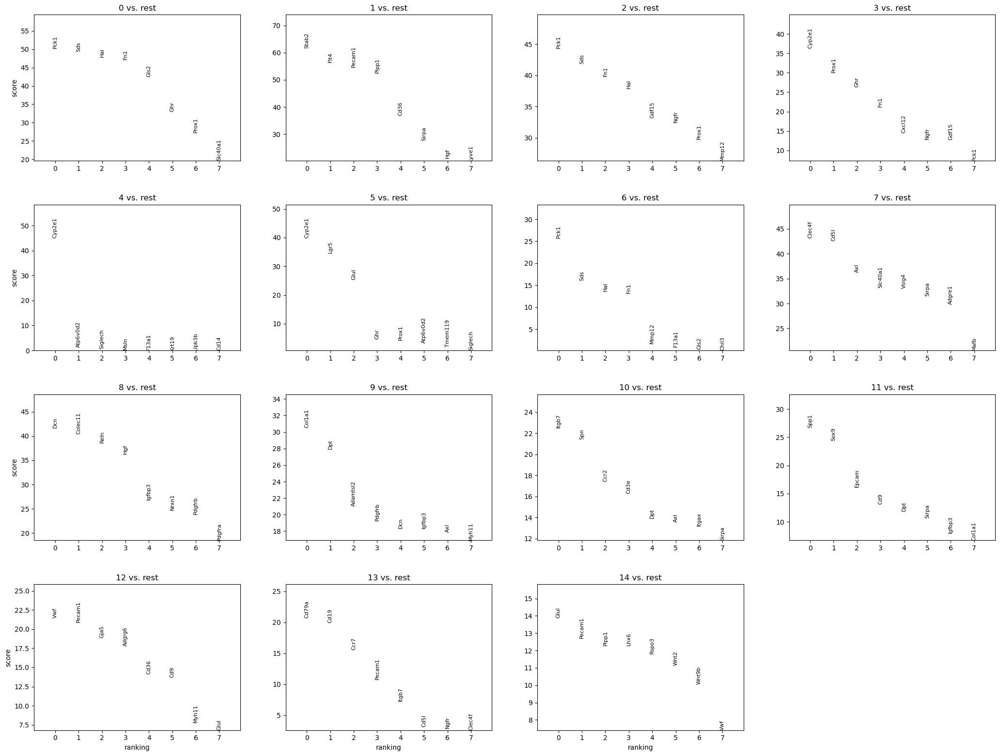

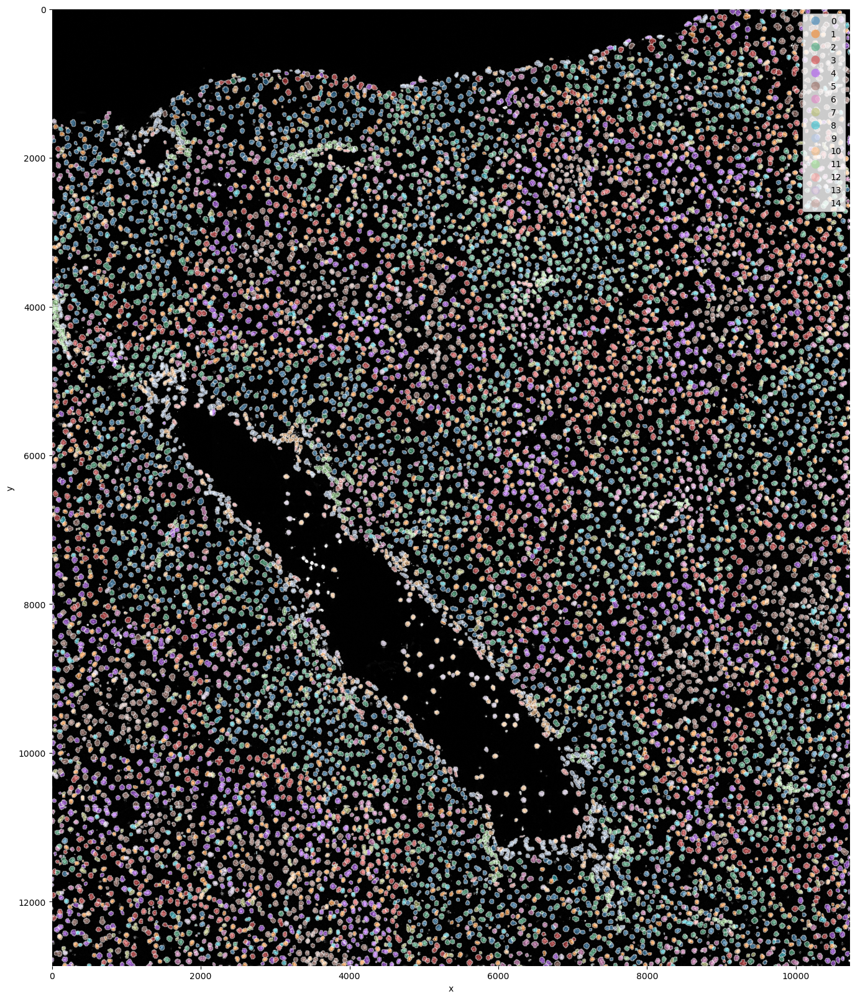

In [24]:
sdata = fc.clustering(sdata, 17, 35)
fc.clustering_plot(sdata)
fc.plot_shapes(sdata, column="leiden")

Here we reuse the plot_shapes function to actually plot a subfigure of our image with the cells colored based on the clustering.

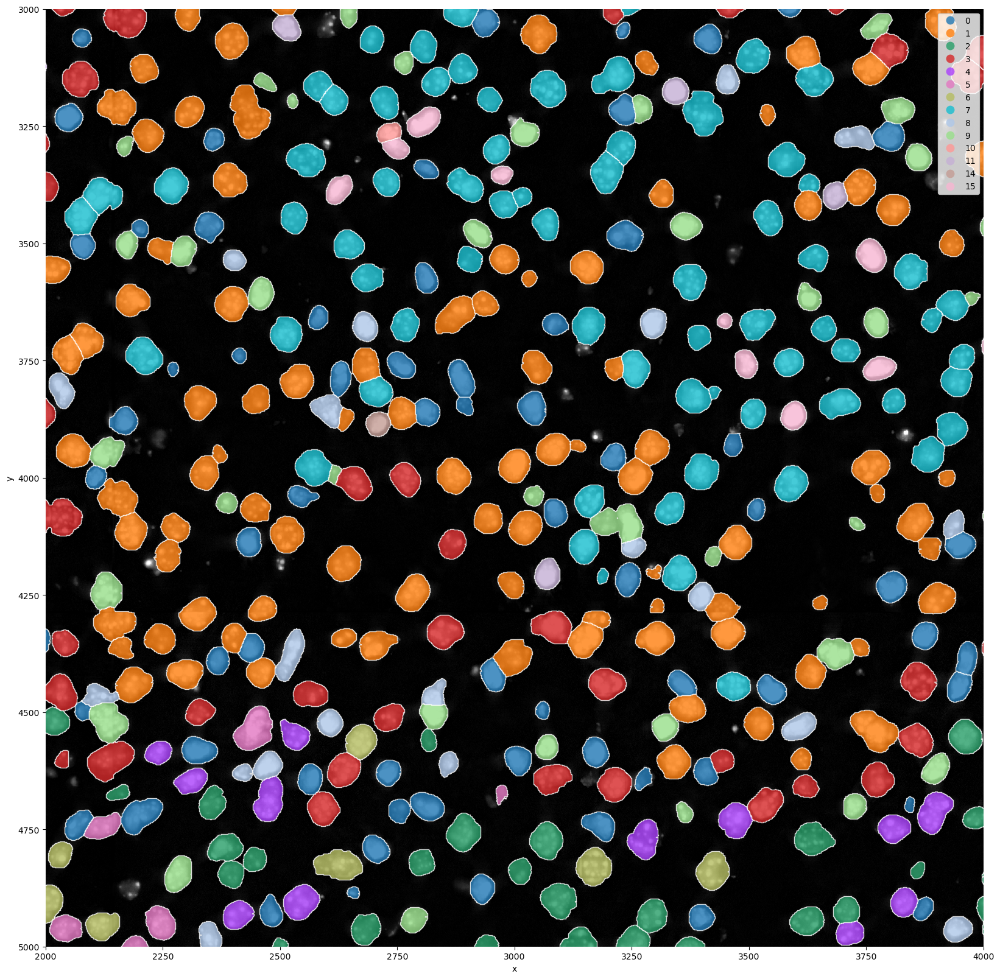

In [28]:
crd = [2000, 4000, 3000, 5000]
if SMALL_IMAGE:
    crd = [2000, 4000, 3000, 4000]

fc.plot_shapes(
    sdata, 
    column="leiden", 
    crd=crd, 
    alpha=0.8, 
    shapes_layer='nucleus_boundaries' 
    )

# Annotating the cells 

In this part of the code we are going to annotate the cells based on the marker geneslist. 
The marker geneslist should be a csv with the genes  in the rows and the celltypes in the columns.
If a certain gene is a marker for a certain celltype, the value of the cell should be 1, otherwise it should be zero. 
This matrix is then used to annotate cells.  The path of the marker geneslist csv file is the input for the function.

All cells are scored for all celltypes. The higher the score the more likely a cell is belonging to a celltype. 

Sometimes some celltypes give way higher scores then others. This is the case in liver for hepatocytes. When you then want readable heatmaps, put the RowNorm=True.
This normalizes the scores within each cell. 

This will not influence which celltype a cell will get, but will influence the plots. 

However, for some downstream adaptations, you will not want this normalization. 


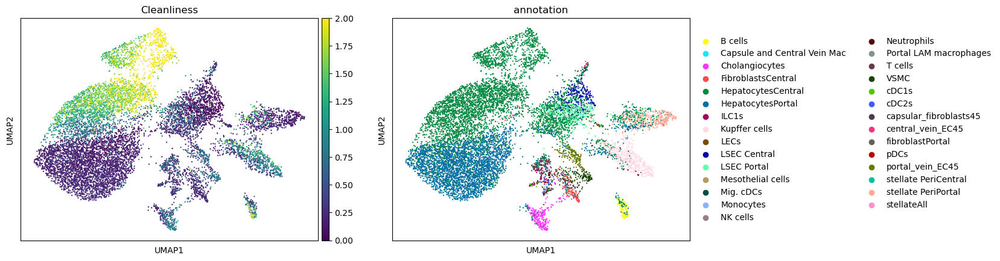

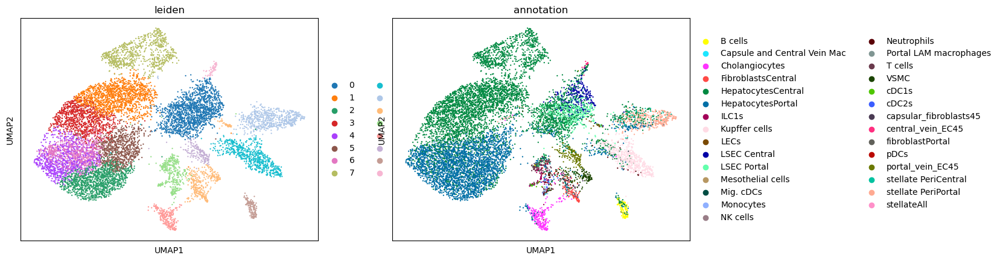

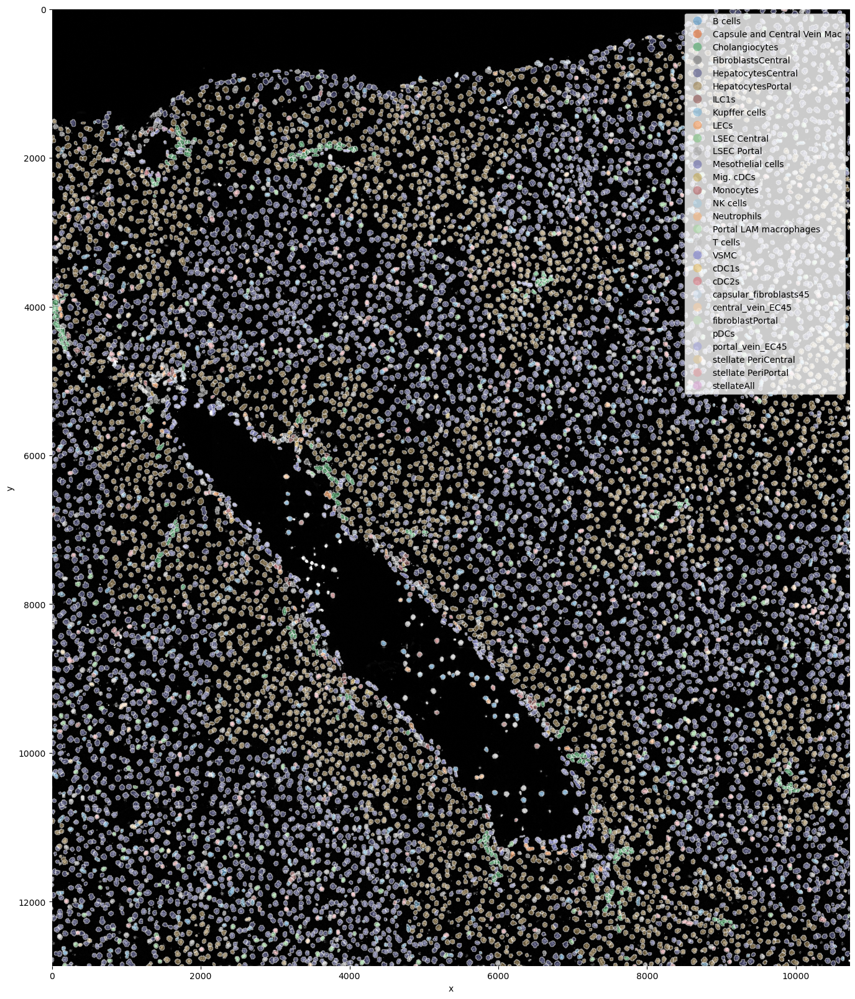

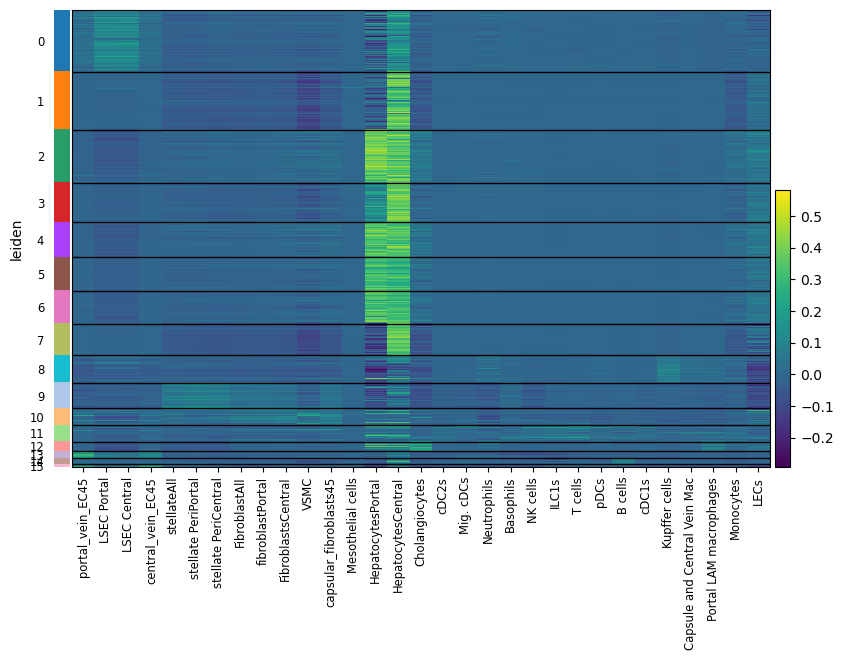

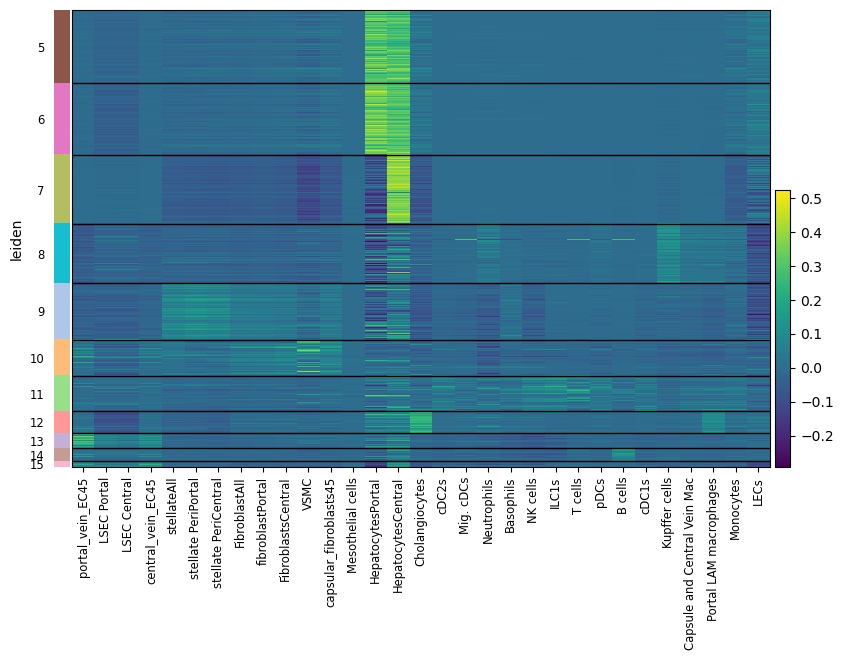

In [29]:
path_mg = DATA_PATH_PREFIX + "/resolve_liver/markerGeneListMartinNoLow.csv"

mg_dict, scoresper_cluster = fc.scoreGenes(
    sdata=sdata,
    path_marker_genes=path_mg, 
    repl_columns={"Tot_Score_": "", "uppfer": "upffer"}, 
    del_celltypes=["Hepatocytes", "LSEC45"])

fc.scoreGenesPlot(
    sdata=sdata, 
    scoresper_cluster=scoresper_cluster, 
    filter_index=5)

In liver, the marker genes for hepatocytes are everywhere, but way higher expressed in hepatocytes. This result in a high score for hepatocytes in cells that aren't hepatocytes. 

But those cells score much lower on being hepatocyte then the hepatocytes itselves. So they clearly aren't hepatocytes. 
In the following code we try to estimate how high of a hepatocyte score we actually need to assign a cell hepatocyte. 
In this case it is only necessary for hepatocytes. For melanoma more were necessary. 

We tried other techniques for annotation, such as Tangram too, but they seem to work even less good.
So this is the best we have at the moment. 

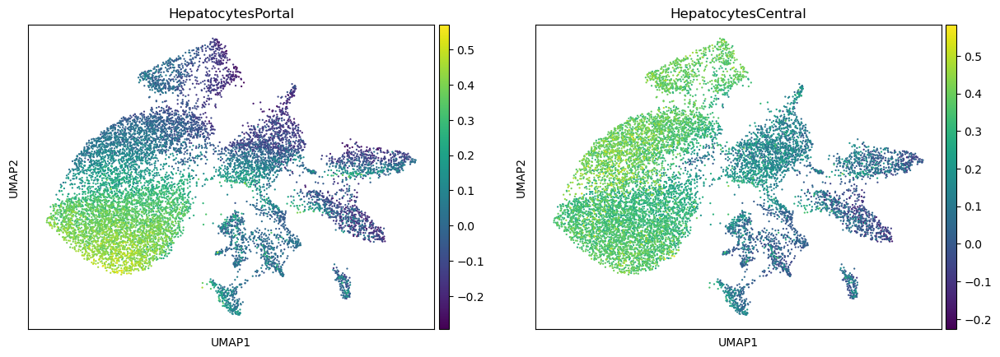

In [30]:
import scanpy as sc
sc.pl.umap(sdata.table, color=["HepatocytesPortal",'HepatocytesCentral'])

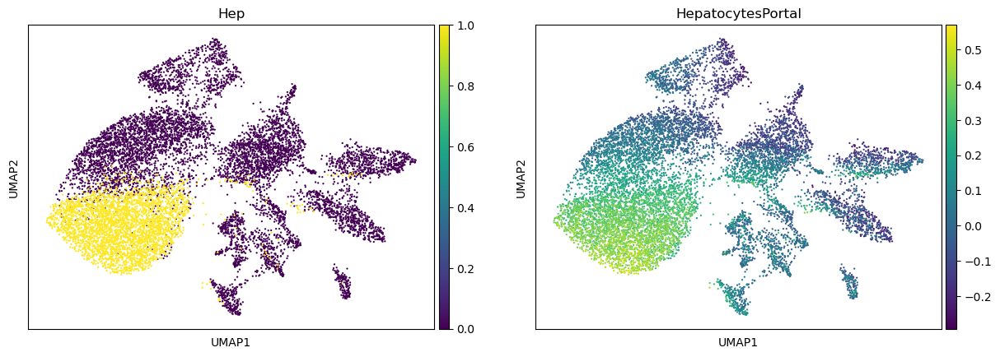

In [31]:
sdata.table.obs["Hep"] = (sdata.table.obs["HepatocytesPortal"]>0.25).astype(int)
sc.pl.umap(sdata.table, color=["Hep","HepatocytesPortal"])

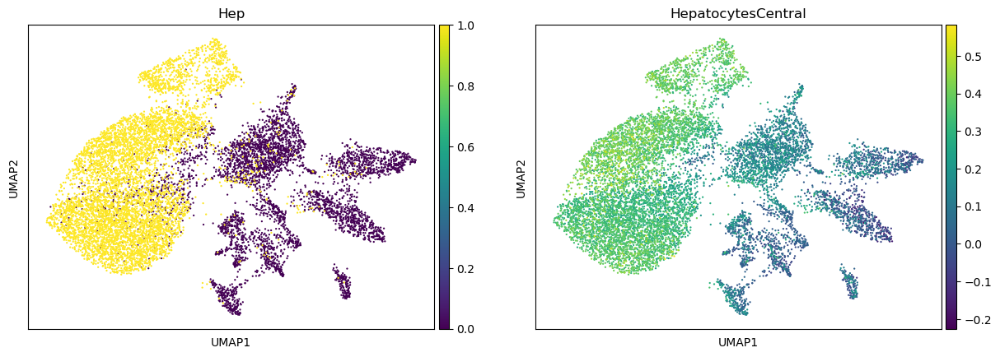

In [32]:
sdata.table.obs["Hep"] = (sdata.table.obs["HepatocytesCentral"]>0.25).astype(int)
sc.pl.umap(sdata.table, color=["Hep","HepatocytesCentral"])

In [33]:
correct_marker_genes=True

if correct_marker_genes:
    sdata = fc.correct_marker_genes(
        sdata=sdata,
        celltype_correction_dict={"HepatocytesPortal": (8.6, 7.0),'HepatocytesCentral':(10.6,7)}) #fix here to hepatocytes portal and central! 

This code checks how well the clusters agree with the celltyping, it looks at every cluster and which celltypes are in there. You would want one celltype per cluster: one color per column.


As not all celltypes can be distinguished based on 100 genes, I combine celltypes. But a better idea would be to adapt the marker genes lists and only include the celltypes you are interested in. 
You can adapt this for your data too. 

in colors, you can define the colors of the clusters. You have to do this in alphabetic order.  
(let me know if making a dict would make it all easier).


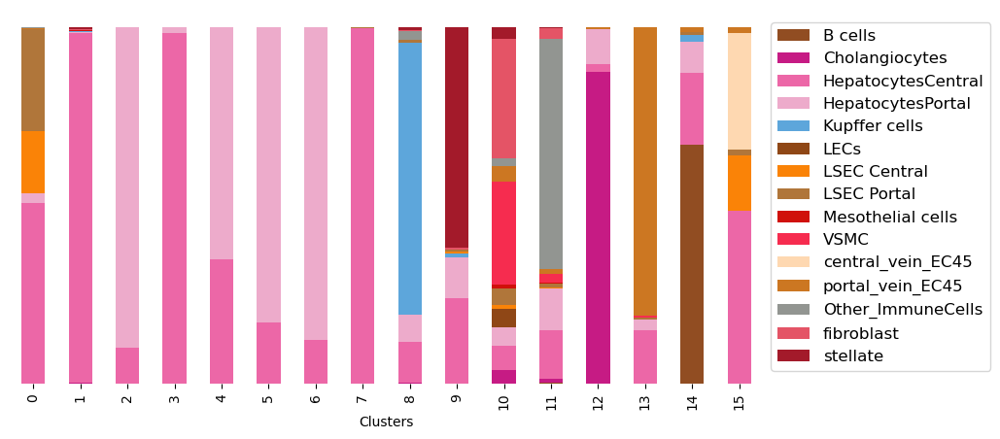

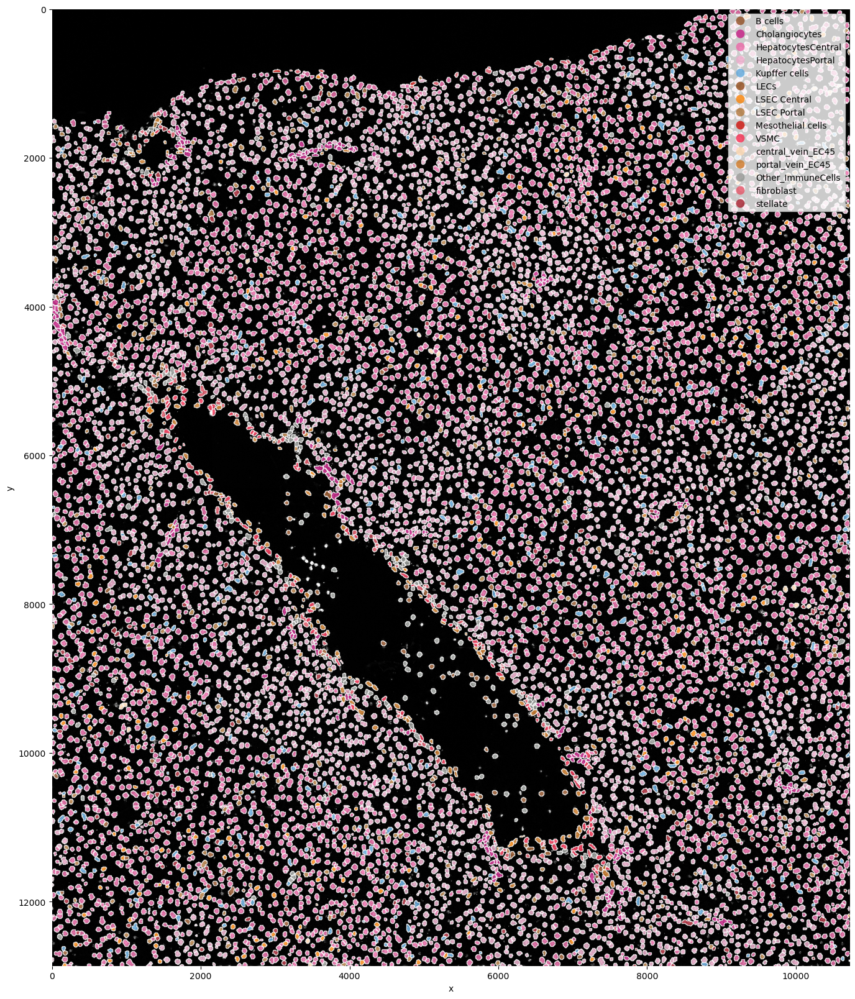

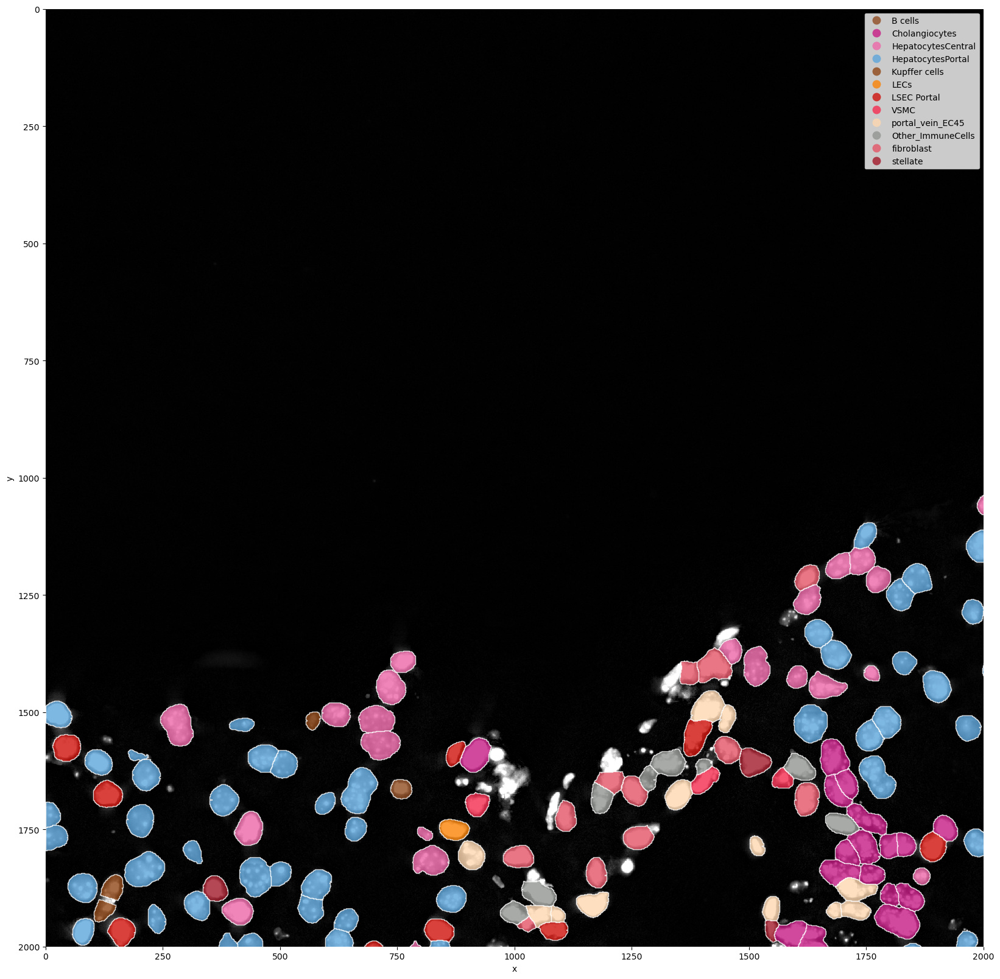

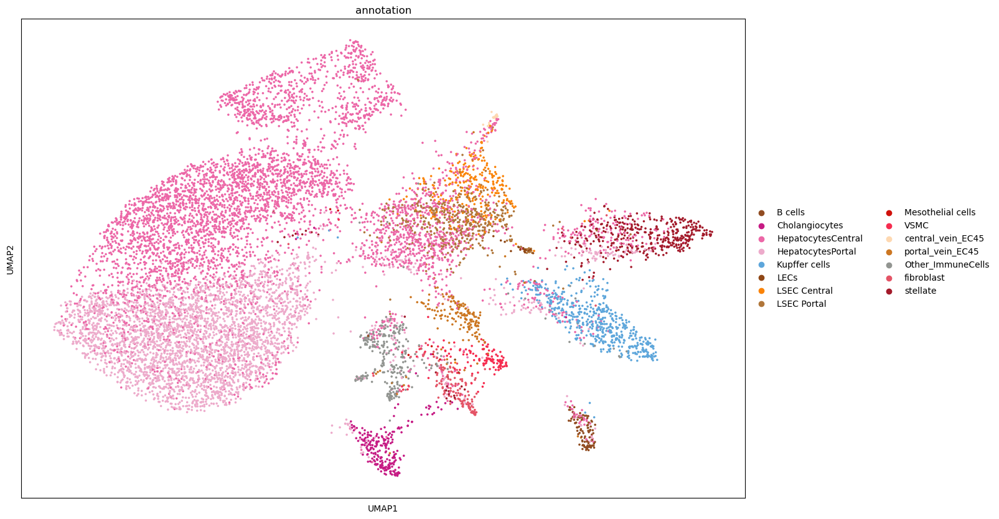

In [34]:
colors = ['#914d22','#c61b84','#ec67a7','#edabcb','#5da6db','#8f4716','#fa8307','#b0763a','#d0110b','#f62c4f','#fed8b1','#cc7722','#929591','#E45466','#a31a2a']
gene_indexes = {"Other_ImmuneCells": [1,2,8,14,15,16,17,18,19,21,22,26], "fibroblast": [4,5,23,25], "stellate": [28,29,30]}

sdata, color_dict = fc.clustercleanliness(
    sdata=sdata, 
    genes=list(mg_dict.keys()), 
    gene_indexes=gene_indexes,
    colors=colors,
    )

fc.clustercleanlinessPlot(
    sdata, 
    color_dict=color_dict, 
    crd=[ 0, 2000, 0, 2000 ],
    )

# squidpy:

spatialData is completely compatible with squidpy, see https://spatialdata.scverse.org/en/latest/tutorials/notebooks/notebooks/examples/squidpy_integration.html.
For the enrichment analysis, we made a wrapper function, but it is quite straightforward in use! 
The plotting of the data with squidpy is also possible. 

In [35]:
sdata = fc.enrichment(sdata) 

  0%|          | 0/1000 [00:00<?, ?/s]

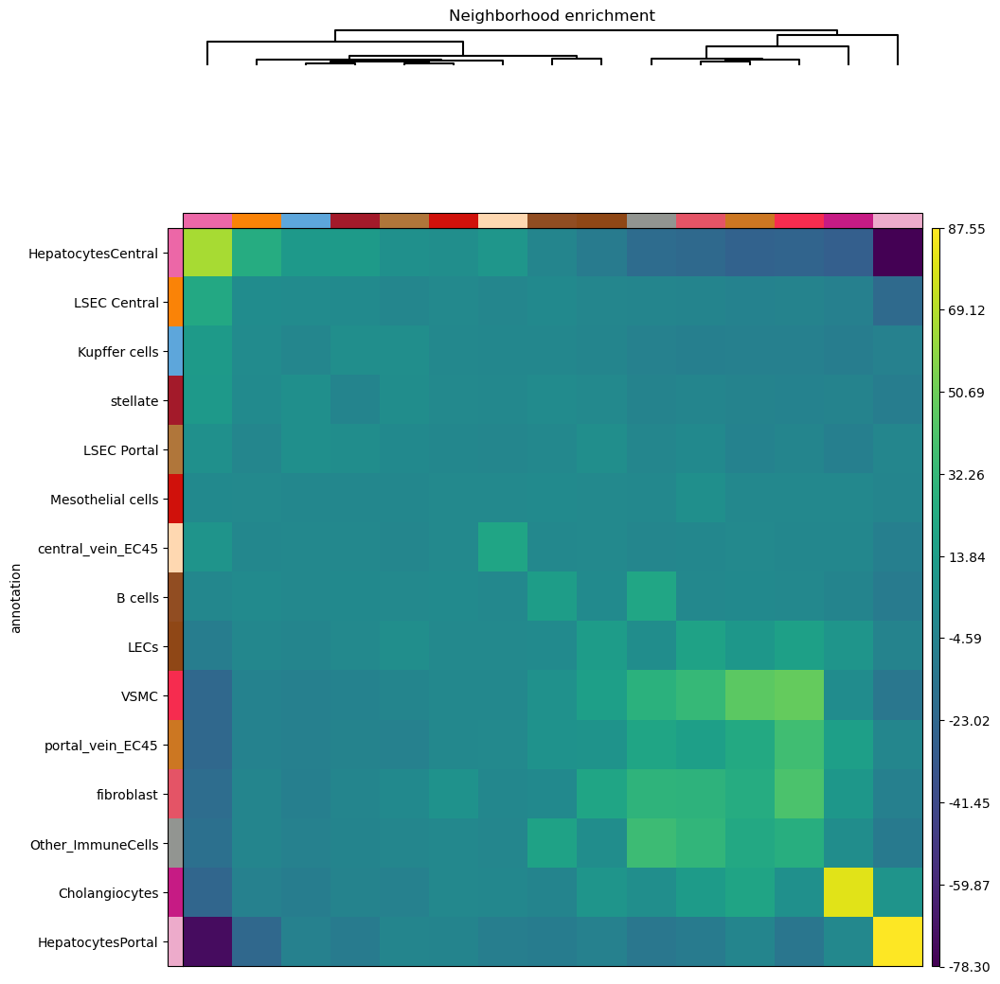

In [36]:
fc.enrichment_plot(sdata)

## Saving data 

By using spatialData, the data is saved automatically at every step and written to disk. 

However, if you still adapt the anndata object outside of the sparrow functions, you will have to run following code to save your anndata object: 